<a href="https://colab.research.google.com/github/adelardw/HSE_Homeworks/blob/main/ML6_VAE/VAE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# This cat does not exist
__Суммарное количество баллов: 10__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [ ]:
import torch
from torch import nn
from torch.optim import Adam,NAdam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!unzip - '/content/drive/MyDrive/cat_136/cat_136.zip'

In [ ]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

In [ ]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="/content/cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size

    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop,
                  y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size),
                         interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1

    def __len__(self):
        return len(self.photo_names)

In [ ]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем кодировщик для нашего VAE. Предлагается использовать следующую архитектуру:
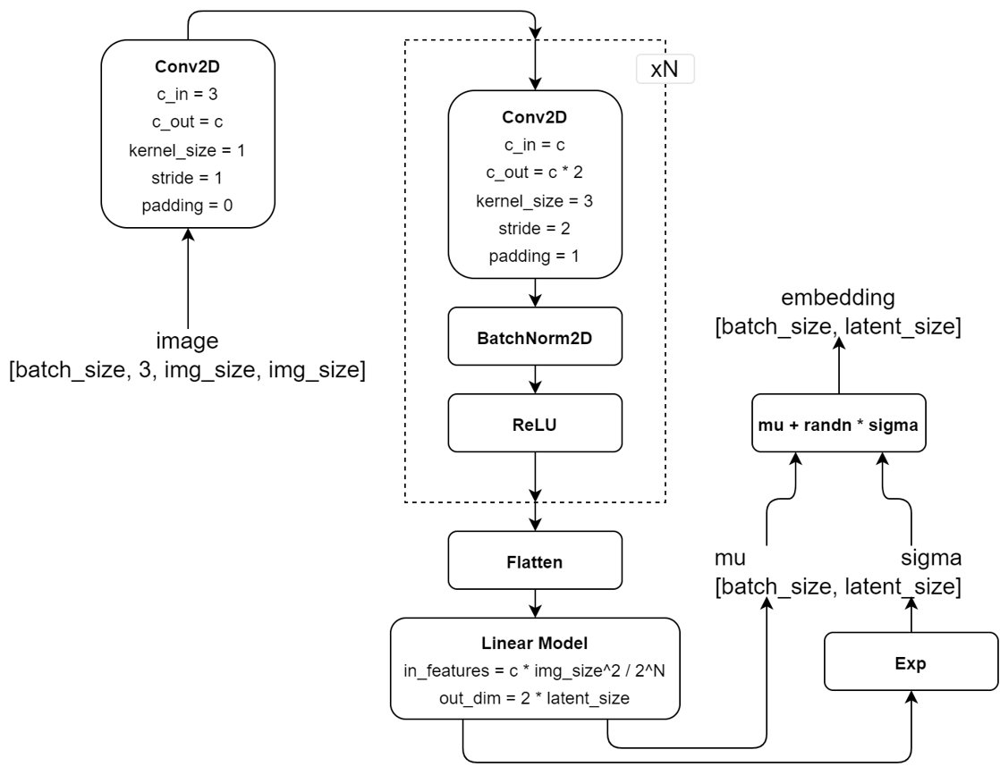
![](imgs/VAE_enc.png)

Для ее реализации вам потребуются модули `nn.Conv2d`, `nn.ReLU`, `nn.Flatten` и `nn.Linear`.

#### Методы
* `__init__` - принимает на вход `img_size`, `latent_size`, `start_channels` и `downsamplings`. Первый аргумент - высота и ширина картинки в пикселях. Второй аргумент - размерность латентного пространства. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены downsampling блоки. `downsamplings` - это количество downsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов увеличивается в два раза.


* `forward` - принимает на вход батч `x`, возвращает эмбеддинг в латентном пространстве `z` и параметры распределения `(mu, sigma)`.


#### Важно
`Linear Model` в схеме - это полносвязная сеть из нескольких слоев. Предлагается такая архитектура:

`[Linear(c * img_size // 2^N -> 256), ReLU, Linear(256 -> 2 * latent_size)]`

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F


# Task 1

class Encoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, start_channels=16,
                 downsamplings=5):
        super().__init__()
        self.img_size = img_size
        self.latent_size = latent_size
        self.start_channels = start_channels
        self.downsamplings = downsamplings


        self.inptl = nn.Conv2d(in_channels=3, out_channels=self.start_channels,
                               kernel_size=1,stride=1,padding=0)

        self.dwn = self.downsamplings_layers()
        self.flt = nn.Flatten()
        self.linear1 = nn.Linear( self.start_channels*self.img_size**2 // (2**self.downsamplings),
                                 256)

        self.relu = nn.ReLU()
        self.linear2 = nn.Linear(256, 2*self.latent_size)




    def downsamplings_layers(self):
        res = []
        self.c = self.start_channels
        for _ in range(self.downsamplings):
            res += [nn.Conv2d(in_channels=self.c,out_channels=self.c*2,
                              kernel_size=3,stride=2,padding=1),
                nn.BatchNorm2d(self.c*2),
                nn.ReLU()]
            self.c *= 2

        res = nn.ModuleList(res)
        return nn.Sequential(*res)

    def forward(self, x):

        x = self.inptl(x)
        x = self.dwn(x)
        x = self.flt(x)

        x = self.linear1(x)
        x = self.relu(x)
        x = self.linear2(x)

        mu = x[:, :self.latent_size]
        sigma = torch.exp(x[:, self.latent_size:])
        rand = torch.randn_like(sigma)

        z = mu + (rand * sigma)

        return z, (mu, sigma)

### Задание 2 (3 балла)
Теперь реализуем декодер для VAE. Предлагается использовать следующую архитектуру:

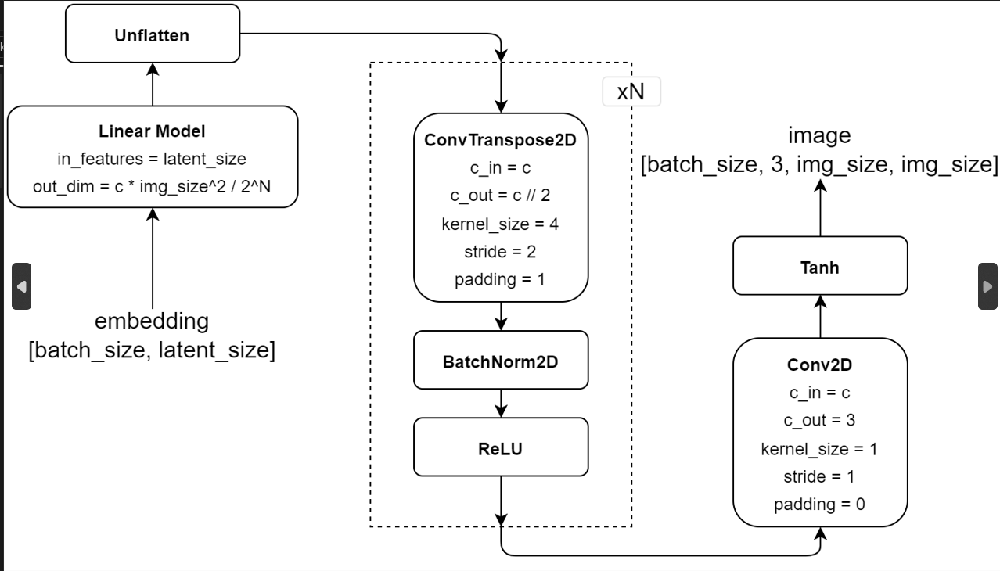![](imgs/VAE_dec.png)

Для ее реализации вам потребуются модули `nn.Linear`, `nn.Unflatten`, `nn.ConvTranspose2d`, `nn.ReLU` и `nn.Tanh`.

#### Методы
* `__init__` - принимает на вход `img_size`, `latent_size`, `end_channels` и `upsamplings`.  Первый аргумент - высота и ширина картинки в пикселях. Второй аргумент - размерность латентного пространства. `end_channels` отвечает за то, сколько каналов должно быть после всех upsampling блоков. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов уменьшается в два раза.


* `forward` - принимает на вход `z` - тензор с латентным представлением изображений. Возвращает батч восстановленных изображений.

#### Важно
`Linear Model` в схеме - это полносвязная сеть из нескольких слоев. Предлагается такая архитектура:

`[Linear(latent_size -> 256), ReLU, Linear(256 -> c * 2^N)]`

In [ ]:
class Decoder(nn.Module):
    def __init__(self, img_size=128,latent_size=1024,end_channels=16,
                 upsamplings=5):
        super().__init__()
        self.img_size = img_size
        self.latent_size = latent_size
        self.end_channels = end_channels
        self.upsamplings = upsamplings
        self.pic_size = self.img_size//2**self.upsamplings



        self.linear1 = nn.Linear(self.latent_size, 256)
        self.relu  =  nn.ReLU()
        self.linear2 = nn.Linear(256,self.end_channels*self.img_size**2//2**self.upsamplings)

        self.unflt = nn.Unflatten(dim=1,unflattened_size=(self.end_channels*2**self.upsamplings,
                                                          self.pic_size,
                                                          self.pic_size) )
        self.upsmpl = self.upsamplings_layers()
        self.convout = nn.Conv2d(in_channels=self.end_channels,
                                 out_channels=3,
                                 kernel_size=1,
                                 stride=1,
                                 padding=0)
        self.pred = nn.Tanh()


    def upsamplings_layers(self):
        res = []
        self.c =  self.end_channels * 2 ** self.upsamplings
        for _ in range(self.upsamplings):
            res += [nn.ConvTranspose2d(in_channels=self.c,
                                       out_channels=self.c // 2,
                                       kernel_size=4,
                                       stride=2,padding=1),
                nn.BatchNorm2d(self.c // 2),
                nn.ReLU()]
            self.c //= 2
        res = nn.ModuleList(res)
        return nn.Sequential(*res)


    def forward(self, z):
        z = self.linear1(z)
        z = self.relu(z)
        z = self.linear2(z)

        z = self.unflt(z)
        z = self.upsmpl(z)
        z = self.convout(z)
        z = self.pred(z)

        return z

### Задание 3 (5 баллов)
Наконец, объединим Encoder и Decoder в Variational Autoencoder.

Полностью архитектура выглядит так:
![](imgs/VAE.png)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.

* `save` - сохраняет чекпоинт обученной модели.

* `load` - загружает сохраненный чекпоинт обученной модели.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [ ]:

class VAE(nn.Module):
    def __init__(self, img_size=128,downsamplings=5,latent_size=96,
                 down_channels=7, up_channels=14):
        super().__init__()
        self.encoder = Encoder(img_size=img_size,downsamplings=downsamplings,
                               latent_size=latent_size,
                               start_channels=down_channels)
        self.decoder = Decoder(img_size=img_size,latent_size=latent_size,
                               end_channels=up_channels,
                               upsamplings=downsamplings)

    def forward(self, x):
        z, (mu,sigma) = self.encoder.forward(x)
        x_pred = self.decoder.forward(z)
        kld = 0.5*(sigma**2 + mu**2 - torch.log(sigma**2) - 1)

        return x_pred, kld

    def encode(self, x):
        z = self.encoder.forward(x)[0]
        return z

    def decode(self, z):
        x_pred =self.decoder.forward(z)
        return x_pred

    def save(self):


        torch.save(self.state_dict(),'/content/drive/MyDrive/vae1w/m.pth')

    def load(self):
        self.load_state_dict(self,torch.load('/content/drive/MyDrive/vae1w/w.pth',map_location=torch.device('cpu') ))
        return self.eval()


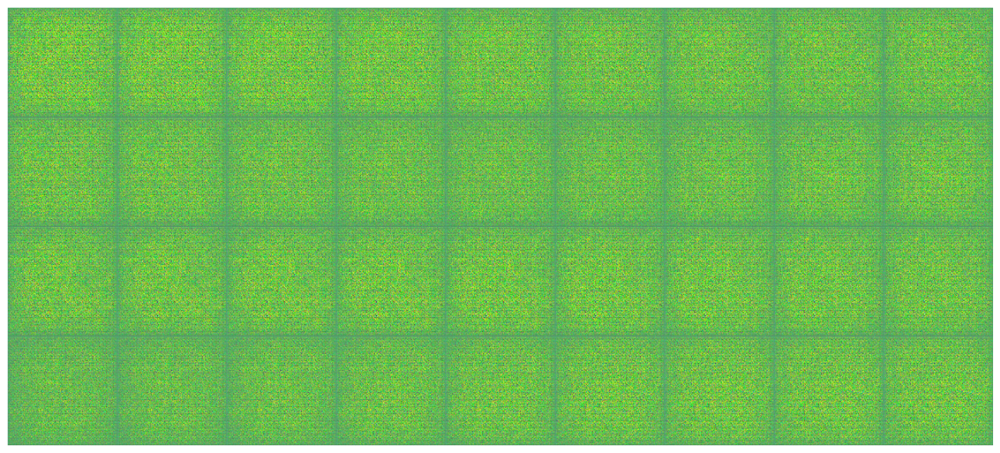

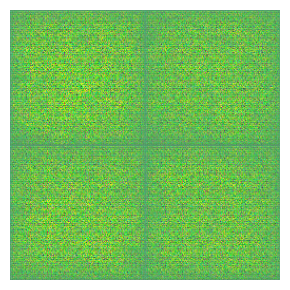

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 9743.650543023341
Epoch 1 | Reconstruction loss: 9743.650543023341 | KLD loss: 207.40452260778557


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 5401.496572553741
Epoch 2 | Reconstruction loss: 5401.496572553741 | KLD loss: 329.19141359506926


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 4713.432874217537
Epoch 3 | Reconstruction loss: 4713.432874217537 | KLD loss: 367.9579565865653


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 4355.893476213728
Epoch 4 | Reconstruction loss: 4355.893476213728 | KLD loss: 378.4926472539487


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 4142.258856921462
Epoch 5 | Reconstruction loss: 4142.258856921462 | KLD loss: 390.4592681789991


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3933.657459709215
Epoch 6 | Reconstruction loss: 3933.657459709215 | KLD loss: 399.92646078737624


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3751.9851760390384
Epoch 7 | Reconstruction loss: 3751.9851760390384 | KLD loss: 402.3685624969672


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3625.3607829786974
Epoch 8 | Reconstruction loss: 3625.3607829786974 | KLD loss: 403.25688915371154


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3513.961403414329
Epoch 9 | Reconstruction loss: 3513.961403414329 | KLD loss: 407.5614305579144


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3442.9576389478602
Epoch 10 | Reconstruction loss: 3442.9576389478602 | KLD loss: 407.9102487030977


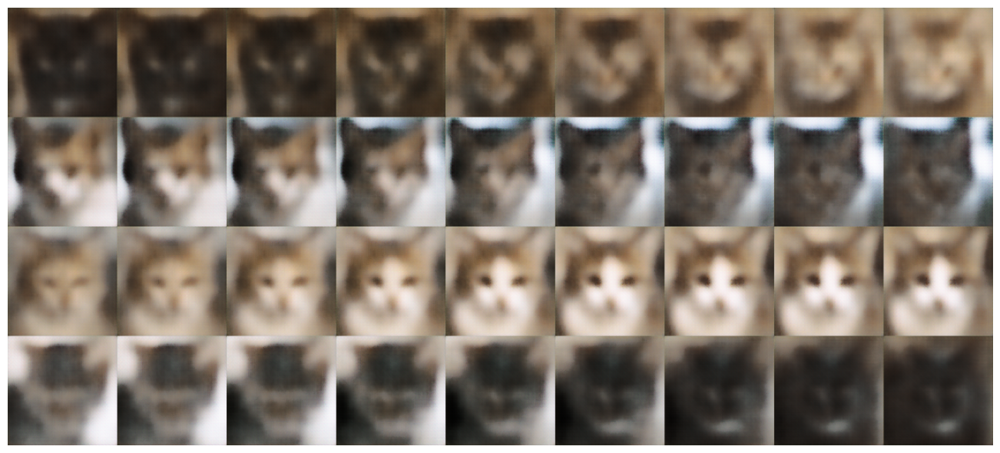

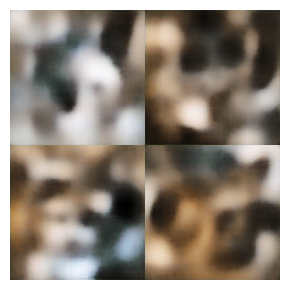

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3359.2147413929056
Epoch 11 | Reconstruction loss: 3359.2147413929056 | KLD loss: 409.1946367062397


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3295.7742398658893
Epoch 12 | Reconstruction loss: 3295.7742398658893 | KLD loss: 409.6373477722547


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3231.694978133492
Epoch 13 | Reconstruction loss: 3231.694978133492 | KLD loss: 409.3448079743


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3184.0955276015384
Epoch 14 | Reconstruction loss: 3184.0955276015384 | KLD loss: 408.2903885456346


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3124.7357450686627
Epoch 15 | Reconstruction loss: 3124.7357450686627 | KLD loss: 408.6320592749933


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3082.2888246145308
Epoch 16 | Reconstruction loss: 3082.2888246145308 | KLD loss: 404.9505557895447


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3049.9761507970206
Epoch 17 | Reconstruction loss: 3049.9761507970206 | KLD loss: 405.3958448327106


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 3018.753706464116
Epoch 18 | Reconstruction loss: 3018.753706464116 | KLD loss: 404.5810577676903


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2980.87070346619
Epoch 19 | Reconstruction loss: 2980.87070346619 | KLD loss: 403.2844098487996


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2953.863626231318
Epoch 20 | Reconstruction loss: 2953.863626231318 | KLD loss: 402.2893067354001


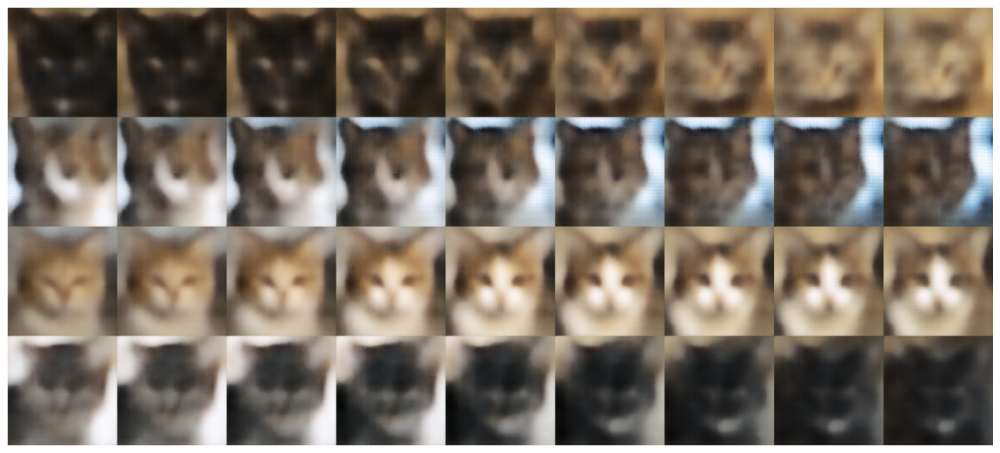

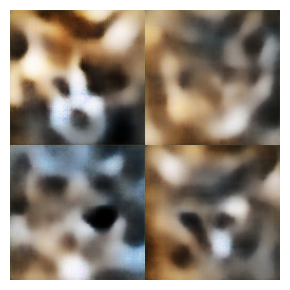

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2930.992859265819
Epoch 21 | Reconstruction loss: 2930.992859265819 | KLD loss: 402.4796936793357


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2894.0574410953877
Epoch 22 | Reconstruction loss: 2894.0574410953877 | KLD loss: 401.0319544632242


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2882.682804842173
Epoch 23 | Reconstruction loss: 2882.682804842173 | KLD loss: 400.50219281119587


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2852.7893843561965
Epoch 24 | Reconstruction loss: 2852.7893843561965 | KLD loss: 399.89283141142096


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2851.110640436966
Epoch 25 | Reconstruction loss: 2851.110640436966 | KLD loss: 399.5794310007036


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2820.0985619207345
Epoch 26 | Reconstruction loss: 2820.0985619207345 | KLD loss: 398.07301250007583


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2797.6198063252136
Epoch 27 | Reconstruction loss: 2797.6198063252136 | KLD loss: 397.6238280112699


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2796.3535061474913
Epoch 28 | Reconstruction loss: 2796.3535061474913 | KLD loss: 396.5886728037959


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2767.2721597422724
Epoch 29 | Reconstruction loss: 2767.2721597422724 | KLD loss: 396.0372062825268


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2763.5563445476273
Epoch 30 | Reconstruction loss: 2763.5563445476273 | KLD loss: 395.8010587988433


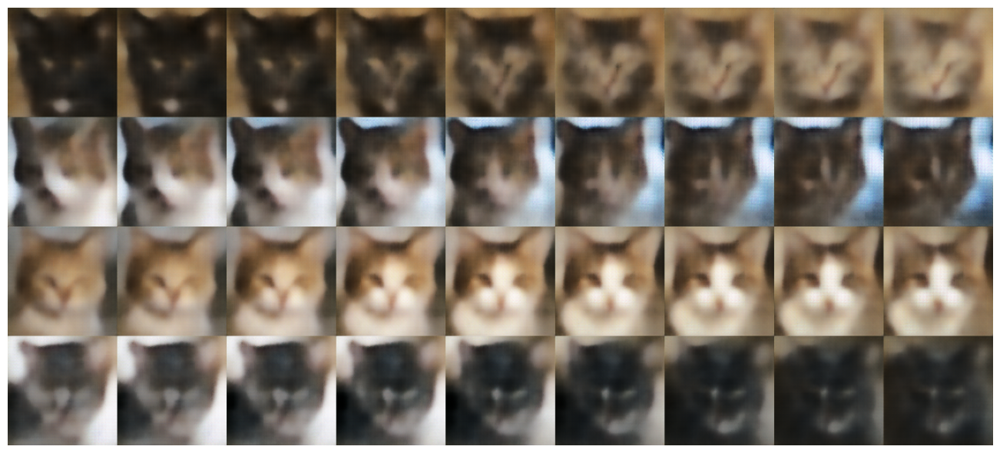

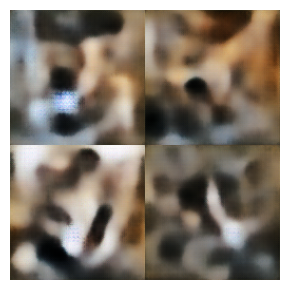

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2742.6623159846904
Epoch 31 | Reconstruction loss: 2742.6623159846904 | KLD loss: 396.234454753236


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2715.74433605123
Epoch 32 | Reconstruction loss: 2715.74433605123 | KLD loss: 396.13808190008126


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2714.5717875794594
Epoch 33 | Reconstruction loss: 2714.5717875794594 | KLD loss: 395.3556147984096


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2690.760020759535
Epoch 34 | Reconstruction loss: 2690.760020759535 | KLD loss: 393.7156853053881


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2688.9544473020187
Epoch 35 | Reconstruction loss: 2688.9544473020187 | KLD loss: 393.3002027428669


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2668.899655359872
Epoch 36 | Reconstruction loss: 2668.899655359872 | KLD loss: 392.8694283621652


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2653.1663384289477
Epoch 37 | Reconstruction loss: 2653.1663384289477 | KLD loss: 393.0241995390898


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2643.58993037443
Epoch 38 | Reconstruction loss: 2643.58993037443 | KLD loss: 392.76710420217574


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2642.9563484902706
Epoch 39 | Reconstruction loss: 2642.9563484902706 | KLD loss: 393.19813940391776


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2630.329625668733
Epoch 40 | Reconstruction loss: 2630.329625668733 | KLD loss: 392.90497702841435


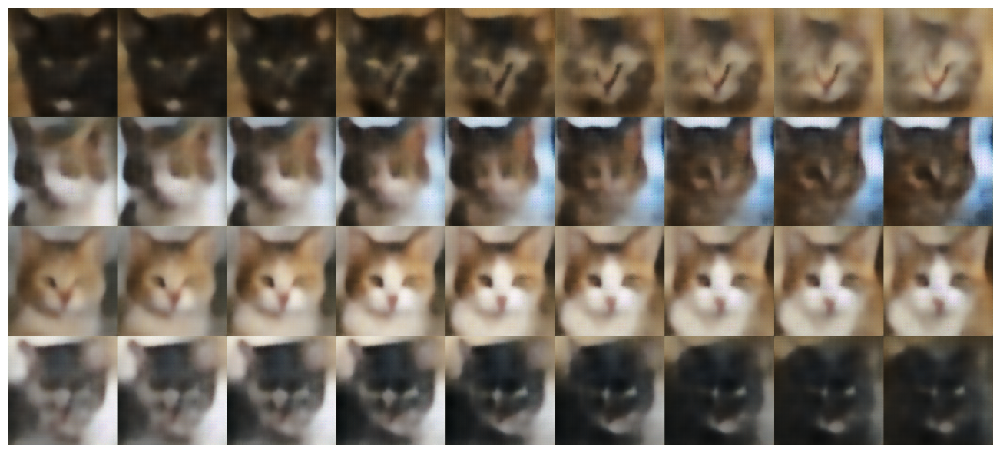

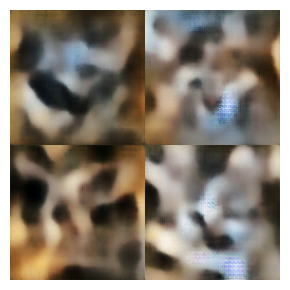

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2607.9852446562013
Epoch 41 | Reconstruction loss: 2607.9852446562013 | KLD loss: 392.06932219511236


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2598.562216622489
Epoch 42 | Reconstruction loss: 2598.562216622489 | KLD loss: 391.2961074165676


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2590.9967238147806
Epoch 43 | Reconstruction loss: 2590.9967238147806 | KLD loss: 392.51469719928247


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2581.6913016183034
Epoch 44 | Reconstruction loss: 2581.6913016183034 | KLD loss: 389.5817721822987


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2577.8062378308787
Epoch 45 | Reconstruction loss: 2577.8062378308787 | KLD loss: 391.36191918983224


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2560.7733751379924
Epoch 46 | Reconstruction loss: 2560.7733751379924 | KLD loss: 391.6004522572393


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2558.108366972171
Epoch 47 | Reconstruction loss: 2558.108366972171 | KLD loss: 391.47397964193215


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2550.9224832665104
Epoch 48 | Reconstruction loss: 2550.9224832665104 | KLD loss: 390.6330645069572


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2535.623733615283
Epoch 49 | Reconstruction loss: 2535.623733615283 | KLD loss: 389.68963940543415


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2525.6283910526254
Epoch 50 | Reconstruction loss: 2525.6283910526254 | KLD loss: 390.1497614131951


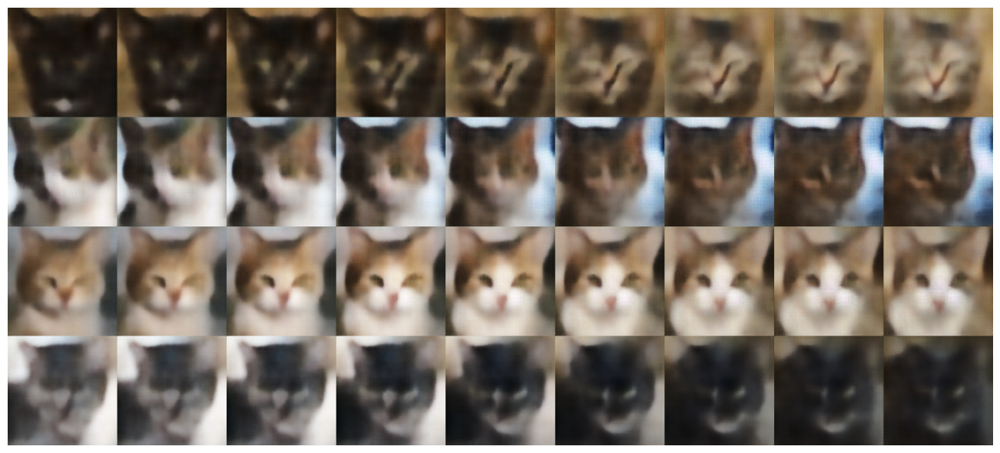

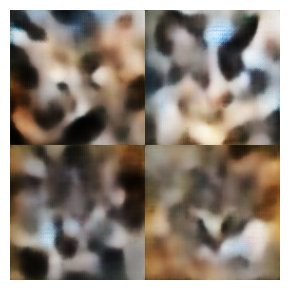

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2519.0389326581303
Epoch 51 | Reconstruction loss: 2519.0389326581303 | KLD loss: 388.6957083281523


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2510.1342288189053
Epoch 52 | Reconstruction loss: 2510.1342288189053 | KLD loss: 389.6524173902429


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 53 | Reconstruction loss: 2512.14658180379 | KLD loss: 388.46431040319595


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2498.6101288410446
Epoch 54 | Reconstruction loss: 2498.6101288410446 | KLD loss: 389.7894437801764


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2490.0136811629586
Epoch 55 | Reconstruction loss: 2490.0136811629586 | KLD loss: 389.7919069373089


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 56 | Reconstruction loss: 2490.0844235627546 | KLD loss: 388.71201774644555


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2476.850763925114
Epoch 57 | Reconstruction loss: 2476.850763925114 | KLD loss: 390.1467170004519


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2471.5775481988185
Epoch 58 | Reconstruction loss: 2471.5775481988185 | KLD loss: 389.60508709072326


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2466.925985205988
Epoch 59 | Reconstruction loss: 2466.925985205988 | KLD loss: 388.02243155722294


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2463.4159727866604
Epoch 60 | Reconstruction loss: 2463.4159727866604 | KLD loss: 388.4018209232307


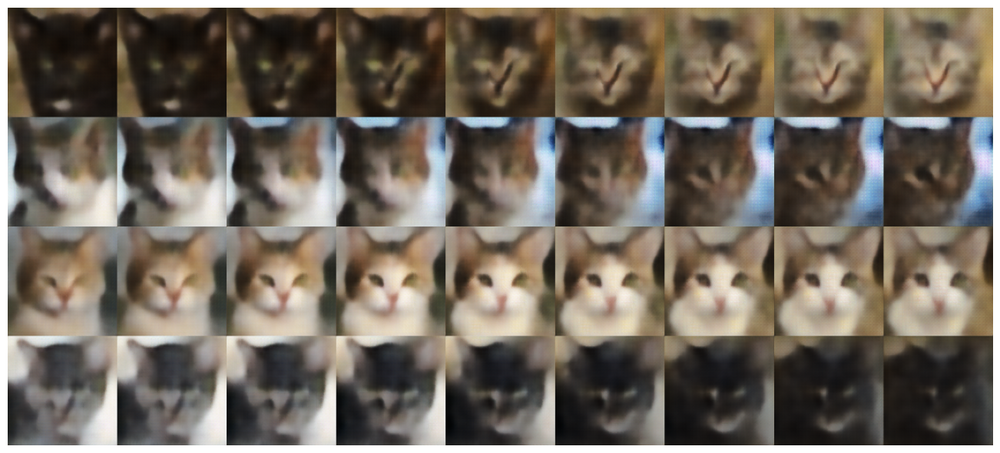

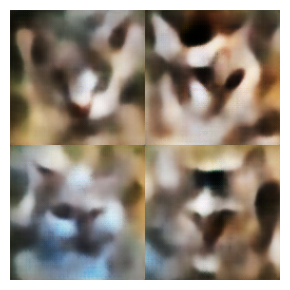

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2461.0183228676365
Epoch 61 | Reconstruction loss: 2461.0183228676365 | KLD loss: 389.0037892027671


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2447.8019742787997
Epoch 62 | Reconstruction loss: 2447.8019742787997 | KLD loss: 388.5686211911788


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2444.751900240501
Epoch 63 | Reconstruction loss: 2444.751900240501 | KLD loss: 387.8964139097226


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 64 | Reconstruction loss: 2446.8706930409307 | KLD loss: 387.8335398324528


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2439.0996588475955
Epoch 65 | Reconstruction loss: 2439.0996588475955 | KLD loss: 387.32056896138636


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2422.7182097820023
Epoch 66 | Reconstruction loss: 2422.7182097820023 | KLD loss: 387.0892661906177


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2411.368590550393
Epoch 67 | Reconstruction loss: 2411.368590550393 | KLD loss: 387.69898982077655


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 68 | Reconstruction loss: 2418.021838265176 | KLD loss: 387.4200984883753


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2406.080686770611
Epoch 69 | Reconstruction loss: 2406.080686770611 | KLD loss: 386.8274277396824


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 70 | Reconstruction loss: 2408.9040258182504 | KLD loss: 386.8746926917793


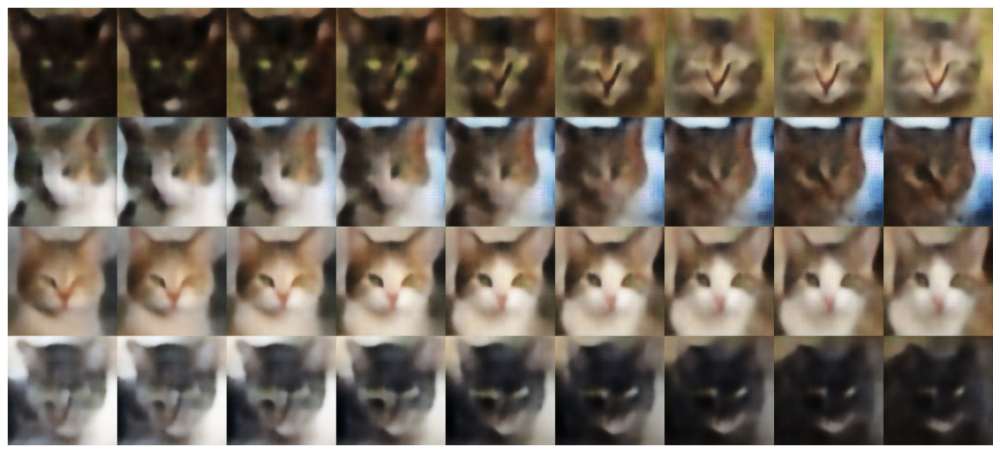

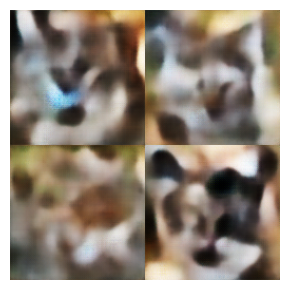

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2398.2474003193543
Epoch 71 | Reconstruction loss: 2398.2474003193543 | KLD loss: 387.90682793848265


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2398.237061494626
Epoch 72 | Reconstruction loss: 2398.237061494626 | KLD loss: 388.1642792032372


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2387.367711416683
Epoch 73 | Reconstruction loss: 2387.367711416683 | KLD loss: 387.22844700783673


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2382.508412615853
Epoch 74 | Reconstruction loss: 2382.508412615853 | KLD loss: 387.64787230876664


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2375.434985616933
Epoch 75 | Reconstruction loss: 2375.434985616933 | KLD loss: 385.87171447943456


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2371.9678001640746
Epoch 76 | Reconstruction loss: 2371.9678001640746 | KLD loss: 385.96098289726683


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 77 | Reconstruction loss: 2377.489589904406 | KLD loss: 387.4994771732307


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2366.4881642975424
Epoch 78 | Reconstruction loss: 2366.4881642975424 | KLD loss: 386.7314524680191


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 79 | Reconstruction loss: 2379.1142822644724 | KLD loss: 386.4748862130301


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2357.441433355675
Epoch 80 | Reconstruction loss: 2357.441433355675 | KLD loss: 385.7119617343689


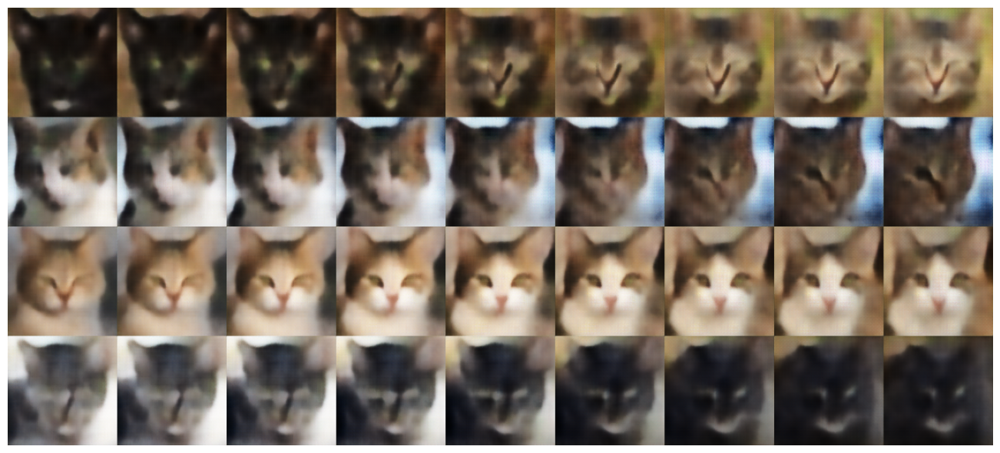

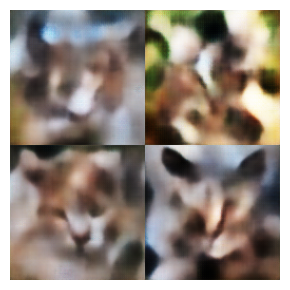

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2351.805630133019
Epoch 81 | Reconstruction loss: 2351.805630133019 | KLD loss: 386.49457407886194


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2347.534847851866
Epoch 82 | Reconstruction loss: 2347.534847851866 | KLD loss: 386.1658681549641


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2344.0643202503275
Epoch 83 | Reconstruction loss: 2344.0643202503275 | KLD loss: 386.40013373712577


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2334.2355049085913
Epoch 84 | Reconstruction loss: 2334.2355049085913 | KLD loss: 385.62723844540045


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2331.886065370548
Epoch 85 | Reconstruction loss: 2331.886065370548 | KLD loss: 385.8883641402914


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 86 | Reconstruction loss: 2335.6017116759876 | KLD loss: 384.38161876038737


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2326.944850187124
Epoch 87 | Reconstruction loss: 2326.944850187124 | KLD loss: 385.22322338412266


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 88 | Reconstruction loss: 2329.092922234387 | KLD loss: 384.5684111221977


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2313.07934001662
Epoch 89 | Reconstruction loss: 2313.07934001662 | KLD loss: 385.0227726527623


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 90 | Reconstruction loss: 2316.261662264048 | KLD loss: 386.1121013001626


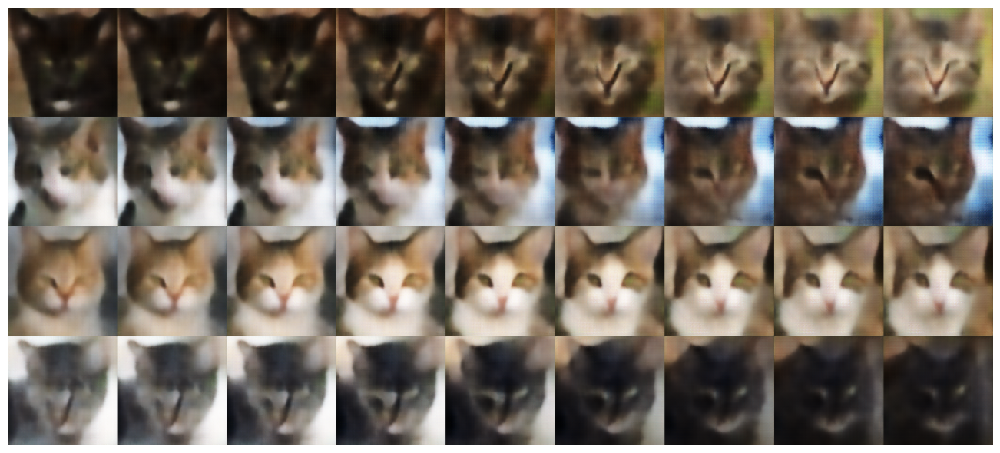

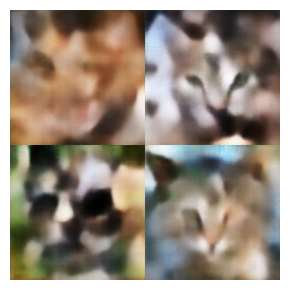

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 91 | Reconstruction loss: 2320.3914237644362 | KLD loss: 384.85970927173304


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2312.7991573736535
Epoch 92 | Reconstruction loss: 2312.7991573736535 | KLD loss: 386.37643247805767


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2305.163279089128
Epoch 93 | Reconstruction loss: 2305.163279089128 | KLD loss: 385.8540354663541


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 94 | Reconstruction loss: 2309.160938713121 | KLD loss: 385.45915800296


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2301.1036475519218
Epoch 95 | Reconstruction loss: 2301.1036475519218 | KLD loss: 384.9163308469405


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2296.9407066203053
Epoch 96 | Reconstruction loss: 2296.9407066203053 | KLD loss: 384.1931637592197


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2295.916675449158
Epoch 97 | Reconstruction loss: 2295.916675449158 | KLD loss: 384.8643342959955


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2290.366050578052
Epoch 98 | Reconstruction loss: 2290.366050578052 | KLD loss: 384.6007597076227


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2285.8462200283266
Epoch 99 | Reconstruction loss: 2285.8462200283266 | KLD loss: 383.737242278105


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 100 | Reconstruction loss: 2286.7751730213995 | KLD loss: 384.9579880992818


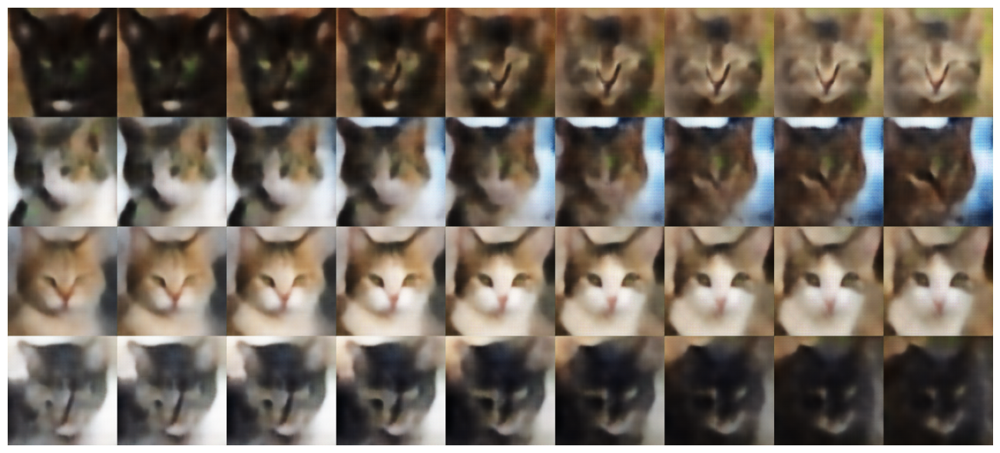

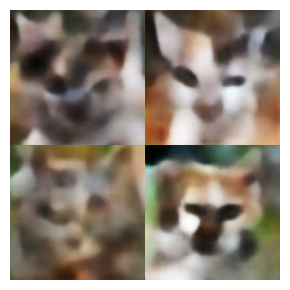

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2282.5352339655715
Epoch 101 | Reconstruction loss: 2282.5352339655715 | KLD loss: 384.8731641591706


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2274.1685464989323
Epoch 102 | Reconstruction loss: 2274.1685464989323 | KLD loss: 384.4477281274262


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 103 | Reconstruction loss: 2275.7160964871046 | KLD loss: 384.3741008687464


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2268.899753736413
Epoch 104 | Reconstruction loss: 2268.899753736413 | KLD loss: 385.26861159993996


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2262.825784623993
Epoch 105 | Reconstruction loss: 2262.825784623993 | KLD loss: 383.5956873923355


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2261.3356076826963
Epoch 106 | Reconstruction loss: 2261.3356076826963 | KLD loss: 384.04745199073176


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 107 | Reconstruction loss: 2265.2637929975617 | KLD loss: 384.3073267018573


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 108 | Reconstruction loss: 2263.8732002210913 | KLD loss: 385.9123085922336


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2261.01796840881
Epoch 109 | Reconstruction loss: 2261.01796840881 | KLD loss: 384.85585955507264


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2250.751315288662
Epoch 110 | Reconstruction loss: 2250.751315288662 | KLD loss: 384.3677325515273


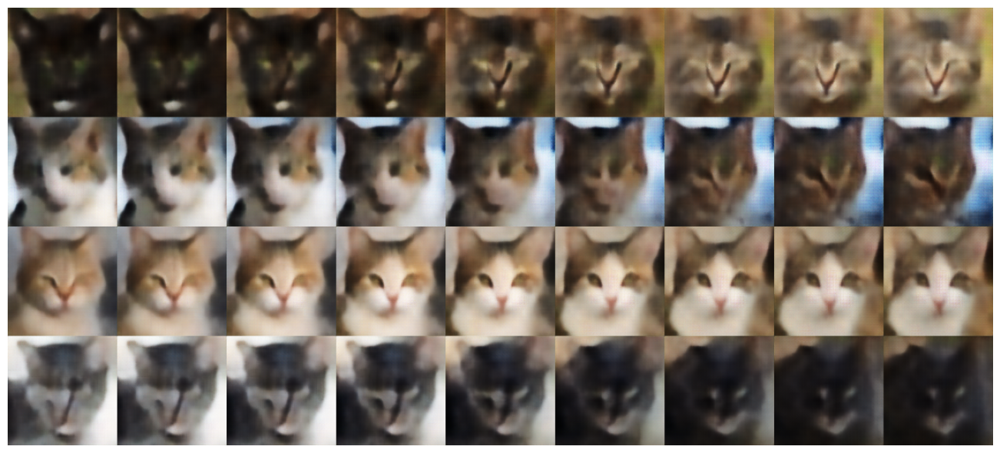

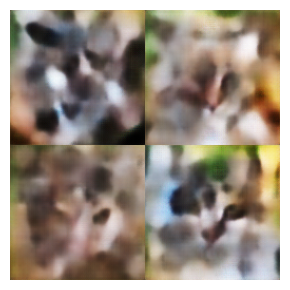

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 111 | Reconstruction loss: 2255.3820738229692 | KLD loss: 385.0112312269507


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 112 | Reconstruction loss: 2251.6943404867043 | KLD loss: 384.4812316420656


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2240.3604823521205
Epoch 113 | Reconstruction loss: 2240.3604823521205 | KLD loss: 384.3456584385463


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 114 | Reconstruction loss: 2246.4056612571576 | KLD loss: 384.0048016376377


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2239.2820771969623
Epoch 115 | Reconstruction loss: 2239.2820771969623 | KLD loss: 385.19379865752984


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2234.6113328637543
Epoch 116 | Reconstruction loss: 2234.6113328637543 | KLD loss: 384.22426425151946


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 117 | Reconstruction loss: 2239.5218754170105 | KLD loss: 383.6015464830102


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2229.768282493449
Epoch 118 | Reconstruction loss: 2229.768282493449 | KLD loss: 383.3011128680306


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2229.096643672967
Epoch 119 | Reconstruction loss: 2229.096643672967 | KLD loss: 383.5462597675205


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2224.720140919182
Epoch 120 | Reconstruction loss: 2224.720140919182 | KLD loss: 384.04072272259253


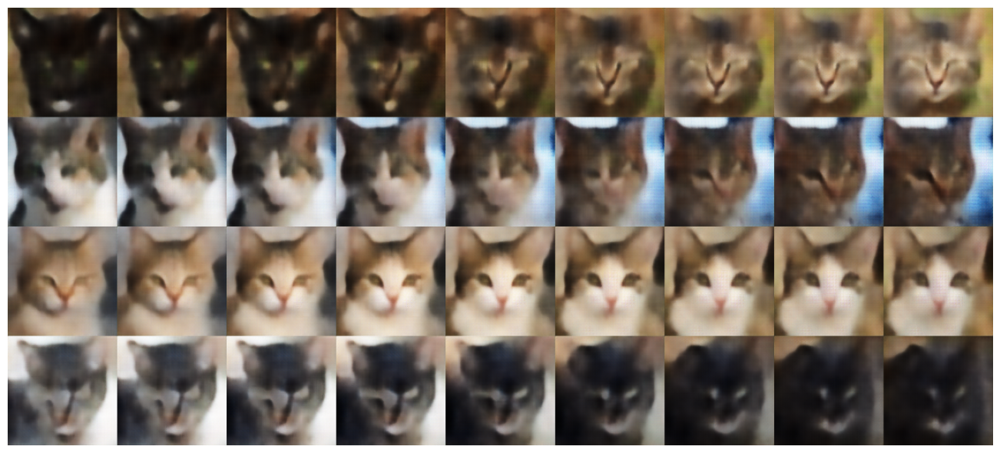

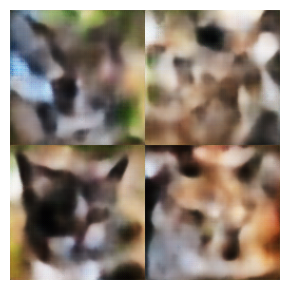

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 121 | Reconstruction loss: 2225.6949495114154 | KLD loss: 383.68342628242067


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2219.6743364985687
Epoch 122 | Reconstruction loss: 2219.6743364985687 | KLD loss: 384.12444741385326


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2213.2723606654577
Epoch 123 | Reconstruction loss: 2213.2723606654577 | KLD loss: 383.64940738085636


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 124 | Reconstruction loss: 2218.122641995827 | KLD loss: 384.88624615402694


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 125 | Reconstruction loss: 2220.3506409070505 | KLD loss: 384.166533713015


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 126 | Reconstruction loss: 2215.6584656519917 | KLD loss: 384.3782763747695


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2202.242212331073
Epoch 127 | Reconstruction loss: 2202.242212331073 | KLD loss: 383.24927241165443


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 128 | Reconstruction loss: 2204.2809795119006 | KLD loss: 383.3813368045025


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2202.0978998219744
Epoch 129 | Reconstruction loss: 2202.0978998219744 | KLD loss: 384.2699704851423


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2201.099940140055
Epoch 130 | Reconstruction loss: 2201.099940140055 | KLD loss: 382.83086456867477


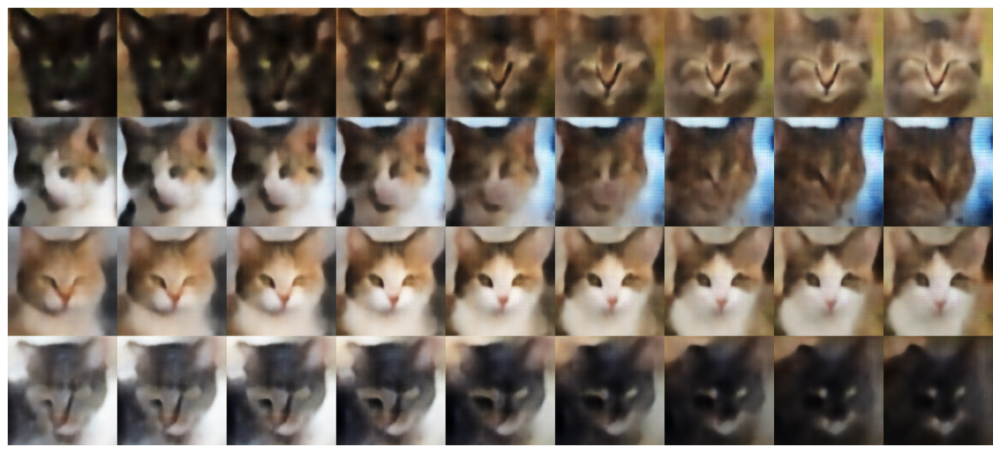

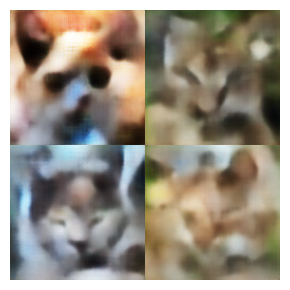

  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2197.4464784231245
Epoch 131 | Reconstruction loss: 2197.4464784231245 | KLD loss: 383.2143584067777


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2195.5235434585475
Epoch 132 | Reconstruction loss: 2195.5235434585475 | KLD loss: 383.26094311068516


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 133 | Reconstruction loss: 2198.178444998605 | KLD loss: 383.0942541560771


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2193.188479784853
Epoch 134 | Reconstruction loss: 2193.188479784853 | KLD loss: 383.8365100363026


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2191.815694299544
Epoch 135 | Reconstruction loss: 2191.815694299544 | KLD loss: 383.91545730496046


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2186.58600270526
Epoch 136 | Reconstruction loss: 2186.58600270526 | KLD loss: 382.8087361021812


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 137 | Reconstruction loss: 2188.353029807902 | KLD loss: 383.52314805688326


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2183.6088319387495
Epoch 138 | Reconstruction loss: 2183.6088319387495 | KLD loss: 383.30159745305224


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2182.268248374418
Epoch 139 | Reconstruction loss: 2182.268248374418 | KLD loss: 383.3527630160314


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2175.5200432250217
Epoch 140 | Reconstruction loss: 2175.5200432250217 | KLD loss: 382.34478072646243


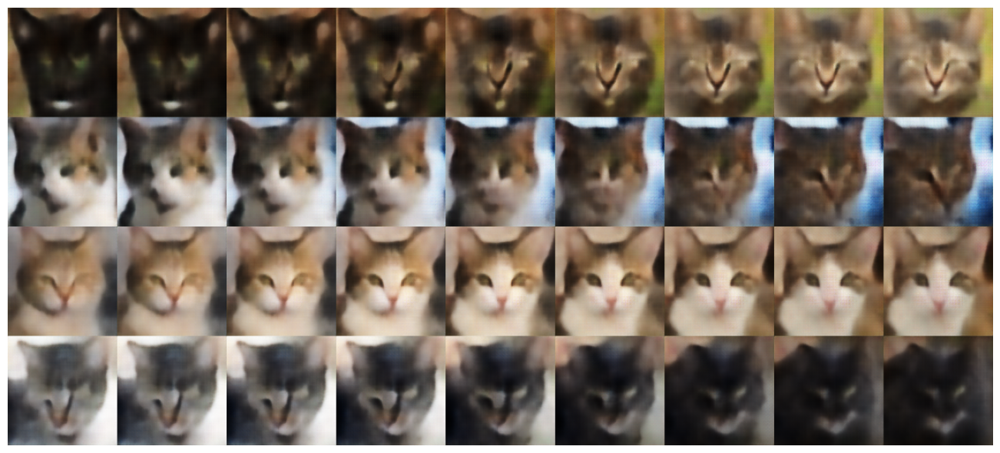

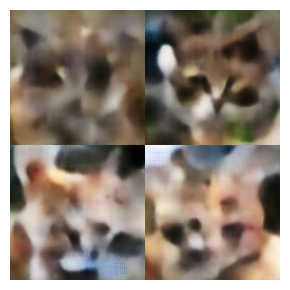

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 141 | Reconstruction loss: 2178.57958984375 | KLD loss: 383.02623962023245


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 142 | Reconstruction loss: 2175.6007229822762 | KLD loss: 382.38139850308437


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2173.8810140479427
Epoch 143 | Reconstruction loss: 2173.8810140479427 | KLD loss: 383.53423702642783


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 144 | Reconstruction loss: 2181.793377988827 | KLD loss: 382.9269079836259


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2170.1860455815095
Epoch 145 | Reconstruction loss: 2170.1860455815095 | KLD loss: 382.4521769648013


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2160.9663165548573
Epoch 146 | Reconstruction loss: 2160.9663165548573 | KLD loss: 382.6396173986589


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 147 | Reconstruction loss: 2165.2407838809563 | KLD loss: 381.15031371501664


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 148 | Reconstruction loss: 2168.32209199704 | KLD loss: 381.98396760928705


  0%|          | 0/645 [00:00<?, ?it/s]

model has been upload at loss = 2159.293094611316
Epoch 149 | Reconstruction loss: 2159.293094611316 | KLD loss: 383.2738772090177


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 150 | Reconstruction loss: 2160.5429054402416 | KLD loss: 382.7093359431865


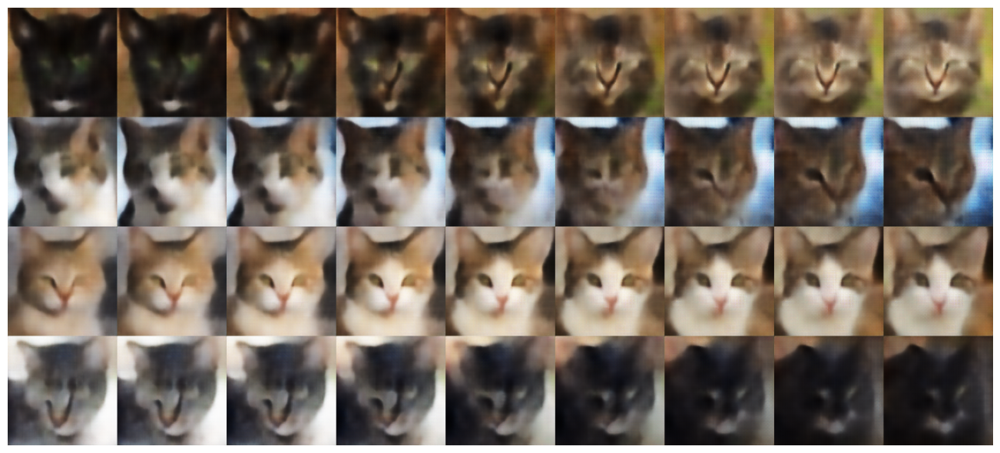

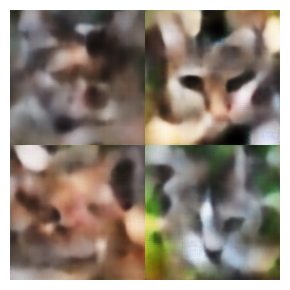

In [ ]:
def train_vae():
    vae = VAE()
    vae.cuda()


    epochs = 201
    batch_size = 8
    vae_optim = NAdam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    maxloss = 1e4

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0
        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            #loss.backward(retain_graph=True)
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()


        if rec_loss_avg / total_batches < maxloss:
              maxloss = rec_loss_avg / total_batches
              print(f'model has been upload at loss = {maxloss}')
              vae.save()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")


train_vae()

In [ ]:
model = VAE().load()